In [4]:
%run common.ipynb

['LC_Type1', 'LST_Day_1km', 'pr', 'aet', 'NDVI', 'EVI']
['LST_Day_1km', 'pr', 'aet', 'NDVI', 'EVI']
['LC_Type1']


In [5]:
BUCKET_NAME = 'lue-model'
BUCKET_FOLDER = 'annual'
UPSTREAM_SUB_FOLDER = 'MODIS_Gpp_Unnormalized'
DOWNSTREAM_SUB_FOLDER = 'fluxnet'
COMPARE_UPSTREAM_SUB_FOLDER = 'MODIS_in_fluxnet'

In [6]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import random
import tensorflow_datasets as tfds

ALL_COLUMNS = FEATURES + [TARGET_FEATURE] + ['cx', 'cy']
columns = [tf.io.FixedLenFeature(shape=[], dtype=tf.float32) for k in ALL_COLUMNS]
FEATURES_DICT = dict(zip(ALL_COLUMNS, columns))


In [7]:
def parse_tfrecord(example_proto):
    """The parsing function.
    Read a serialized example into the structure defined by FEATURES_DICT.
    Args:
    example_proto: a serialized Example.
    Returns:
    A dictionary of tensors, keyed by feature name.
    """
    parsed_features = tf.io.parse_single_example(example_proto, FEATURES_DICT)
    # print(f'Parsed features: {parsed_features}')
    return parsed_features

def get_dataframe(pattern):
    """Function to read, parse and format to tuple a set of input tfrecord files.
    Get all the files matching the pattern, parse and convert to tuple.
    Args:
    pattern: A file pattern to match in a Cloud Storage bucket.
    Returns:
    A tf.data.Dataset
    """
    glob = tf.io.gfile.glob(pattern)
    # print(glob)
    dataset = tf.data.TFRecordDataset(glob, compression_type='GZIP')
    dataset = dataset.map(parse_tfrecord, num_parallel_calls=5)
    # dataset = dataset.map(to_tuple, num_parallel_calls=5)
    df = tfds.as_dataframe(dataset)
    return df

In [8]:
def concat(df_list):
    return pd.concat(df_list, ignore_index=True)

In [9]:
def drop_invalid_rows(df):
    df = df.drop(df[df['Gpp'] > 60000].index)    
    df = df.drop(df[df['cy'] < 10].index)    
    return df

## Read upstream & downstream data

In [10]:
UPSTREAM_DATA_PATH = f'{BUCKET_FOLDER}/{UPSTREAM_SUB_FOLDER}/'
DOWNSTREAM_DATA_PATH = f'{BUCKET_FOLDER}/{DOWNSTREAM_SUB_FOLDER}/'

In [11]:
UPSTREAM_EXTRA_DATA_PATH = f'{BUCKET_FOLDER}/{UPSTREAM_SUB_FOLDER}_extra/'
df_upstream_train = concat([
    get_dataframe(f'{UPSTREAM_DATA_PATH}*_201*.tfrecord.gz'), 
    get_dataframe(f'{UPSTREAM_DATA_PATH}*_2020*.tfrecord.gz'),
    get_dataframe(f'{UPSTREAM_EXTRA_DATA_PATH}*_201*.tfrecord.gz'),
    get_dataframe(f'{UPSTREAM_EXTRA_DATA_PATH}*_2020*.tfrecord.gz'),
])

df_upstream_val = concat([
    get_dataframe(f'{UPSTREAM_DATA_PATH}*_2021*.tfrecord.gz'),
    get_dataframe(f'{UPSTREAM_EXTRA_DATA_PATH}*_2021*.tfrecord.gz')
])
# df_train = tfds.as_dataframe(dataset_upstream_train)
print(len(df_upstream_train))
print(len(df_upstream_val))

158603
26435


Remove invalid Gpp

In [12]:
df_upstream_train = drop_invalid_rows(df_upstream_train)
df_upstream_val = drop_invalid_rows(df_upstream_val)
print(f'upstream training dataset: {len(df_upstream_train)}')
print(f'upstream validation dataset: {len(df_upstream_val)}')

upstream training dataset: 141623
upstream validation dataset: 23624


In [13]:
df_downstream_train = concat([
    get_dataframe(f'{DOWNSTREAM_DATA_PATH}*_20[0-1]*.tfrecord.gz'), 
    get_dataframe(f'{DOWNSTREAM_DATA_PATH}*_2020*.tfrecord.gz')
])
df_downstream_test = get_dataframe(f'{DOWNSTREAM_DATA_PATH}*_202[1-2].tfrecord.gz')
print(len(df_downstream_train))
print(len(df_downstream_test))

996
160


In [14]:
df_downstream_train = drop_invalid_rows(df_downstream_train)
df_downstream_test = drop_invalid_rows(df_downstream_test)
print(len(df_downstream_train))
print(len(df_downstream_test))

991
156


In [15]:
import plotly.graph_objects as go

def plot_samples_on_map(df_to_plot, size=5, colorscale='Viridis'):
    fig = go.Figure(go.Scattergeo(
        lat=df_to_plot['cy'],
        lon=df_to_plot['cx'],
        marker=dict(size=size, color=df_to_plot['LC_Type1'], colorscale=colorscale)
    ), layout=dict(height=1200, width=1500, margin={"r":0,"t":0,"l":0,"b":0}))
    fig.update_geos(
        fitbounds="locations",
        showcountries=True,
        showocean=True, oceancolor = 'white',
        showland=True, landcolor="white")
    fig.show()

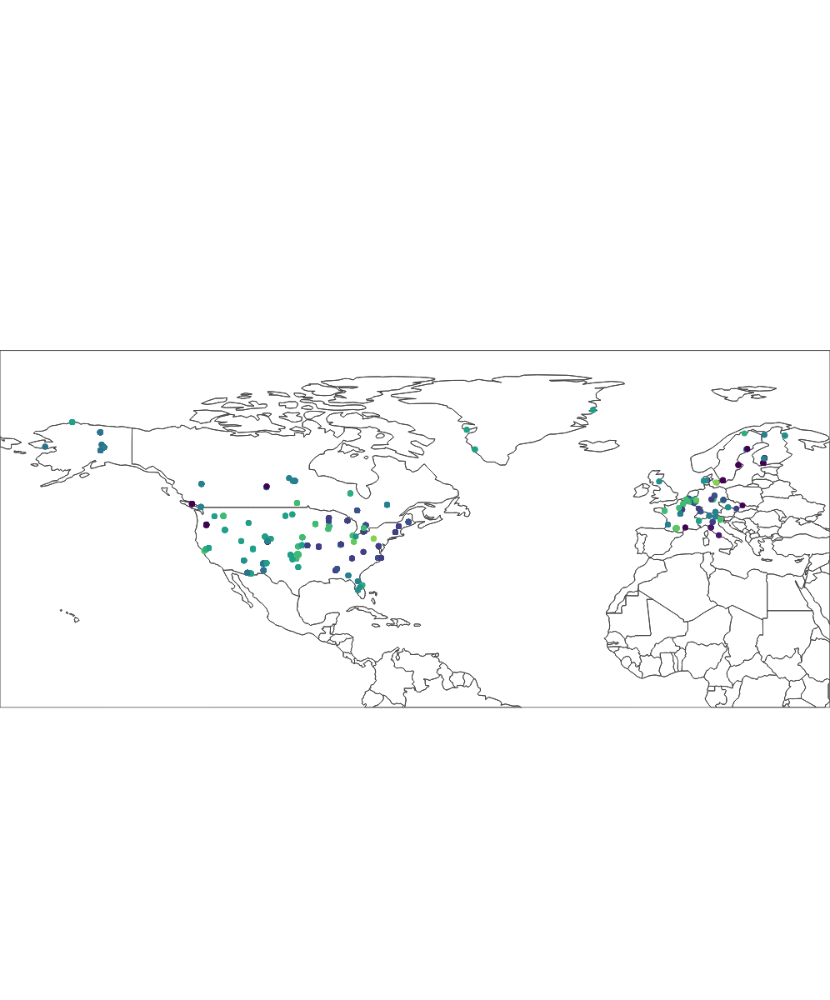

In [16]:
plot_samples_on_map(concat([df_downstream_train, df_downstream_test]), size=7)

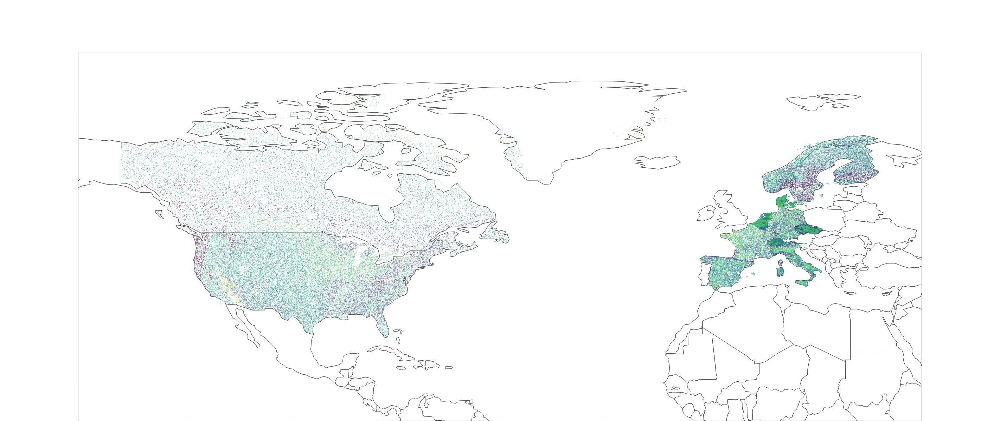

In [17]:
plot_samples_on_map(concat([df_upstream_train, df_upstream_val]), size=1)